# Lead Scoring Case Study - Logistic Regression

## Problem Statement

#### The case study aims to build a logistic regression model to assign a lead score between 0 and 100 to each of the leads which can be used by the company to target potential leads.
An education company named X Education sells online courses to industry professionals. On any given day, many professionals who are interested in the courses land on their website and browse for courses. 

The company markets its courses on several websites and search engines like Google. Once these people land on the website, they might browse the courses or fill up a form for the course or watch some videos. When these people fill up a form providing their email address or phone number, they are classified to be a lead. Moreover, the company also gets leads through past referrals. Once these leads are acquired, employees from the sales team start making calls, writing emails, etc. Through this process, some of the leads get converted while most do not. The typical lead conversion rate at X education is around 30%. 
Now, although X Education gets a lot of leads, its lead conversion rate is very poor. For example, if, say, they acquire 100 leads in a day, only about 30 of them are converted. To make this process more efficient, the company wishes to identify the most potential leads, also known as ‘Hot Leads’. If they successfully identify this set of leads, the lead conversion rate should go up as the sales team will now be focusing more on communicating with the potential leads rather than making calls to everyone. 

There are a lot of leads generated in the initial stage but only a few of them come out as paying customers from the bottom. In the middle stage, we need to nurture the potential leads well in order to get a higher lead conversion.

X Education need to select the most promising leads, i.e. the leads that are most likely to convert into paying customers. The company has to build a model to assign a lead score to each of the leads such that the customers with a higher lead score have a higher conversion chance and the customers with a lower lead score have a lower conversion chance. The CEO, in particular, has given a ballpark of the target lead conversion rate to be around 80%.



#### Business Goal:
- Build a logistic regression model to assign a lead score between 0 and 100 to each of the leads which can be used by the company to target potential leads. A higher score would mean that the lead is hot, i.e. is most likely to convert whereas a lower score would mean that the lead is cold and will mostly not get converted.

- There are some more problems presented by the company which the model should be able to adjust to if the company's requirement changes in the future so they need to be handled as well. 

In [1]:
#importing the warnings.
import warnings
warnings.filterwarnings("ignore")

In [2]:
#importing the useful libraries.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from scipy import stats
import statsmodels.api as sm

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import metrics
from sklearn.metrics import classification_report,recall_score,roc_auc_score,roc_curve,accuracy_score,precision_score,precision_recall_curve,confusion_matrix
from sklearn.preprocessing import LabelEncoder

### Step 1 : Data understanding and exploration

In [3]:
# Reading the data from csv file 'Leads.csv' in 'leads'
leads=pd.read_csv('Leads.csv')

In [4]:
## Printing the dataframe head
leads.head()

,Prospect ID,Lead Number,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,...,Get updates on DM Content,Lead Profile,City,Asymmetrique Activity Index,Asymmetrique Profile Index,Asymmetrique Activity Score,Asymmetrique Profile Score,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity
0,7927b2df-8bba-4d29-b9a2-b6e0beafe620,660737,API,Olark Chat,No,No,0,0.0,0,0.0,...,No,Select,Select,02.Medium,02.Medium,15.0,15.0,No,No,Modified
1,2a272436-5132-4136-86fa-dcc88c88f482,660728,API,Organic Search,No,No,0,5.0,674,2.5,...,No,Select,Select,02.Medium,02.Medium,15.0,15.0,No,No,Email Opened
2,8cc8c611-a219-4f35-ad23-fdfd2656bd8a,660727,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,...,No,Potential Lead,Mumbai,02.Medium,01.High,14.0,20.0,No,Yes,Email Opened
3,0cc2df48-7cf4-4e39-9de9-19797f9b38cc,660719,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,...,No,Select,Mumbai,02.Medium,01.High,13.0,17.0,No,No,Modified
4,3256f628-e534-4826-9d63-4a8b88782852,660681,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,...,No,Select,Mumbai,02.Medium,01.High,15.0,18.0,No,No,Modified


In [5]:
## Understanding overall entries and their data type
leads.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9240 entries, 0 to 9239
Data columns (total 37 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Prospect ID                                    9240 non-null   object 
 1   Lead Number                                    9240 non-null   int64  
 2   Lead Origin                                    9240 non-null   object 
 3   Lead Source                                    9204 non-null   object 
 4   Do Not Email                                   9240 non-null   object 
 5   Do Not Call                                    9240 non-null   object 
 6   Converted                                      9240 non-null   int64  
 7   TotalVisits                                    9103 non-null   float64
 8   Total Time Spent on Website                    9240 non-null   int64  
 9   Page Views Per Visit                           9103 

In [6]:
## Finding out number of rows and columns
leads.shape

(9240, 37)

In [7]:
## Understanding the summary statistics of numerical columns
leads.describe()

,Lead Number,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Asymmetrique Activity Score,Asymmetrique Profile Score
count,9240.000000,9240.000000,9103.000000,9240.000000,9103.000000,5022.000000,5022.000000
mean,617188.435606,0.385390,3.445238,487.698268,2.362820,14.306252,16.344883
std,23405.995698,0.486714,4.854853,548.021466,2.161418,1.386694,1.811395
min,579533.000000,0.000000,0.000000,0.000000,0.000000,7.000000,11.000000
25%,596484.500000,0.000000,1.000000,12.000000,1.000000,14.000000,15.000000
50%,615479.000000,0.000000,3.000000,248.000000,2.000000,14.000000,16.000000
75%,637387.250000,1.000000,5.000000,936.000000,3.000000,15.000000,18.000000
max,660737.000000,1.000000,251.000000,2272.000000,55.000000,18.000000,20.000000


In [8]:
## Finding out the columns
leads.columns

Index(['Prospect ID', 'Lead Number', 'Lead Origin', 'Lead Source',
       'Do Not Email', 'Do Not Call', 'Converted', 'TotalVisits',
       'Total Time Spent on Website', 'Page Views Per Visit', 'Last Activity',
       'Country', 'Specialization', 'How did you hear about X Education',
       'What is your current occupation',
       'What matters most to you in choosing a course', 'Search', 'Magazine',
       'Newspaper Article', 'X Education Forums', 'Newspaper',
       'Digital Advertisement', 'Through Recommendations',
       'Receive More Updates About Our Courses', 'Tags', 'Lead Quality',
       'Update me on Supply Chain Content', 'Get updates on DM Content',
       'Lead Profile', 'City', 'Asymmetrique Activity Index',
       'Asymmetrique Profile Index', 'Asymmetrique Activity Score',
       'Asymmetrique Profile Score',
       'I agree to pay the amount through cheque',
       'A free copy of Mastering The Interview', 'Last Notable Activity'],
      dtype='object')

In [9]:
## To display all the rows and columns when a code is executed
pd.options.display. max_columns = None
pd.options.display. max_rows = None

In [10]:
# Checking for duplicates
leads.loc[leads.duplicated()]

,Prospect ID,Lead Number,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Country,Specialization,How did you hear about X Education,What is your current occupation,What matters most to you in choosing a course,Search,Magazine,Newspaper Article,X Education Forums,Newspaper,Digital Advertisement,Through Recommendations,Receive More Updates About Our Courses,Tags,Lead Quality,Update me on Supply Chain Content,Get updates on DM Content,Lead Profile,City,Asymmetrique Activity Index,Asymmetrique Profile Index,Asymmetrique Activity Score,Asymmetrique Profile Score,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity


In [11]:
# Checking for the missing values in the dataset
leads.isnull().sum()

Prospect ID                                         0
Lead Number                                         0
Lead Origin                                         0
Lead Source                                        36
Do Not Email                                        0
Do Not Call                                         0
Converted                                           0
TotalVisits                                       137
Total Time Spent on Website                         0
Page Views Per Visit                              137
Last Activity                                     103
Country                                          2461
Specialization                                   1438
How did you hear about X Education               2207
What is your current occupation                  2690
What matters most to you in choosing a course    2709
Search                                              0
Magazine                                            0
Newspaper Article           

In [12]:
# Finding the null percentages across columns
round(leads.isnull().sum()/len(leads.index),2)*100

Prospect ID                                       0.0
Lead Number                                       0.0
Lead Origin                                       0.0
Lead Source                                       0.0
Do Not Email                                      0.0
Do Not Call                                       0.0
Converted                                         0.0
TotalVisits                                       1.0
Total Time Spent on Website                       0.0
Page Views Per Visit                              1.0
Last Activity                                     1.0
Country                                          27.0
Specialization                                   16.0
How did you hear about X Education               24.0
What is your current occupation                  29.0
What matters most to you in choosing a course    29.0
Search                                            0.0
Magazine                                          0.0
Newspaper Article           

In [13]:
# Finding column names for 'Select' level
s_col=list(leads.columns)
for i in s_col:
    if 'Select' in leads[i].values:
        print(i)

Specialization
How did you hear about X Education
Lead Profile
City


##### Inference:
- There are total 9240 rows and 37 columns
- There are no duplicates in the data
- There are missing values in the dataset, with few columns having >25% of null values. They need to be treated
- Datatypes of the column : 4 float64, 3 int64, 30 object (7 Numeric and 30 categorical columns)
- There are 4 columns with 'Select' which needs to be handled

### Step 2 : Data cleaning

In [14]:
# Before treating null values, replacing 'Select' with NaN as select indicates no options were selected
leads = leads.replace('Select',np.nan)

In [15]:
# Re-checking that all 'select' values are replaced
s_col=list(leads.columns)
for i in s_col:
    if 'Select' in leads[i].values:
        print(i)

In [16]:
# Finding the null percentages across columns
round(leads.isnull().sum().sort_values(ascending=False)/len(leads.index),2)*100

How did you hear about X Education               78.0
Lead Profile                                     74.0
Lead Quality                                     52.0
Asymmetrique Profile Score                       46.0
Asymmetrique Activity Score                      46.0
Asymmetrique Activity Index                      46.0
Asymmetrique Profile Index                       46.0
City                                             40.0
Specialization                                   37.0
Tags                                             36.0
What matters most to you in choosing a course    29.0
What is your current occupation                  29.0
Country                                          27.0
Page Views Per Visit                              1.0
TotalVisits                                       1.0
Last Activity                                     1.0
Lead Source                                       0.0
Receive More Updates About Our Courses            0.0
I agree to pay the amount th

In [17]:
# Since some of the columns have very high % of missing values, dropping the columns with >50% missing values
leads = leads.drop(leads.loc[:, list(round(100 * (leads.isnull().sum() / len(leads.index)), 2) > 50)].columns, axis=1)

In [18]:
# Re-checking for null percentages after dropping columns with >50% missing values
round(leads.isnull().sum().sort_values(ascending=False)/len(leads.index),2)*100

Asymmetrique Profile Score                       46.0
Asymmetrique Activity Score                      46.0
Asymmetrique Profile Index                       46.0
Asymmetrique Activity Index                      46.0
City                                             40.0
Specialization                                   37.0
Tags                                             36.0
What matters most to you in choosing a course    29.0
What is your current occupation                  29.0
Country                                          27.0
TotalVisits                                       1.0
Page Views Per Visit                              1.0
Last Activity                                     1.0
Lead Source                                       0.0
Update me on Supply Chain Content                 0.0
Get updates on DM Content                         0.0
Prospect ID                                       0.0
Through Recommendations                           0.0
I agree to pay the amount th

##### Dropping the columns not useful for analysis
1. 'Lead Number','Prospect ID': only a record index and unique for each entry
2. 'Asymmetrique Activity Index', 'Asymmetrique Activity Score', 'Asymmetrique Profile Index', 'Asymmetrique Profile Score' : only an internally assigned index / score to each customer based on their activity

In [19]:
leads = leads.drop(['Lead Number','Prospect ID', 'Asymmetrique Activity Index','Asymmetrique Activity Score', 'Asymmetrique Profile Index', 'Asymmetrique Profile Score'], axis=1)

In [20]:
# Re-checking for null percentages 
round(leads.isnull().sum().sort_values(ascending=False)/len(leads.index),2)*100

City                                             40.0
Specialization                                   37.0
Tags                                             36.0
What matters most to you in choosing a course    29.0
What is your current occupation                  29.0
Country                                          27.0
TotalVisits                                       1.0
Page Views Per Visit                              1.0
Last Activity                                     1.0
Lead Source                                       0.0
Receive More Updates About Our Courses            0.0
Update me on Supply Chain Content                 0.0
Lead Origin                                       0.0
Digital Advertisement                             0.0
Get updates on DM Content                         0.0
I agree to pay the amount through cheque          0.0
A free copy of Mastering The Interview            0.0
Through Recommendations                           0.0
Magazine                    

##### Analysis & Missing value treatment
Analysing remaining columns one by one for missing values and device a treatment accordingly

In [21]:
#Checking value counts of "City" column
round(leads['City'].value_counts(normalize=True, dropna=False), 2) * 100

City
NaN                            40.0
Mumbai                         35.0
Thane & Outskirts               8.0
Other Cities                    7.0
Other Cities of Maharashtra     5.0
Other Metro Cities              4.0
Tier II Cities                  1.0
Name: proportion, dtype: float64

In [22]:
# Mumbai is the single most highest value with no other specific cities named. Also null values are 40%
# Hence this column may not be very useful for analysis and can be dropped
leads.drop(['City'], axis = 1, inplace = True)

In [23]:
#Checking value counts of "Specialization" column
round(leads['Specialization'].value_counts(normalize=True, dropna=False), 2) * 100

Specialization
NaN                                  37.0
Finance Management                   11.0
Human Resource Management             9.0
Marketing Management                  9.0
Operations Management                 5.0
Business Administration               4.0
IT Projects Management                4.0
Supply Chain Management               4.0
Banking, Investment And Insurance     4.0
Travel and Tourism                    2.0
Media and Advertising                 2.0
International Business                2.0
Healthcare Management                 2.0
Hospitality Management                1.0
E-COMMERCE                            1.0
Retail Management                     1.0
Rural and Agribusiness                1.0
E-Business                            1.0
Services Excellence                   0.0
Name: proportion, dtype: float64

In [24]:
# Since the specilisation is varied and an important column for analysis, we will not drop this column
# We will rather impute the NaN values with 'Others' as there is no single major specialisation with huge margin of difference
leads['Specialization'].fillna('Others', inplace=True)

In [25]:
#Checking value counts of "Tags" column
round(leads['Tags'].value_counts(normalize=True, dropna=False), 2) * 100

Tags
NaN                                                  36.0
Will revert after reading the email                  22.0
Ringing                                              13.0
Interested in other courses                           6.0
Already a student                                     5.0
Closed by Horizzon                                    4.0
switched off                                          3.0
Busy                                                  2.0
Lost to EINS                                          2.0
Not doing further education                           2.0
Interested  in full time MBA                          1.0
Graduation in progress                                1.0
invalid number                                        1.0
Diploma holder (Not Eligible)                         1.0
wrong number given                                    1.0
opp hangup                                            0.0
number not provided                                   0.0
in touch 

In [26]:
# Imputing the NaN values with 'Not specified' as this is one of the important column to be retained
leads['Tags'].fillna('Not specified', inplace=True)

In [27]:
#Checking value counts of "What matters most to you in choosing a course" column
round(leads['What matters most to you in choosing a course'].value_counts(normalize=True, dropna=False), 2) * 100

What matters most to you in choosing a course
Better Career Prospects      71.0
NaN                          29.0
Flexibility & Convenience     0.0
Other                         0.0
Name: proportion, dtype: float64

In [28]:
# 'Better Career Prospects' is the only reason occuring 71% of times and remaining 29% is NaN.
# Hence we can drop this column as no much inference can be made in future
leads.drop(['What matters most to you in choosing a course'], axis = 1, inplace = True)

In [29]:
#Checking value counts of "What is your current occupation" column
round(leads['What is your current occupation'].value_counts(normalize=True, dropna=False), 2) * 100

What is your current occupation
Unemployed              61.0
NaN                     29.0
Working Professional     8.0
Student                  2.0
Other                    0.0
Housewife                0.0
Businessman              0.0
Name: proportion, dtype: float64

In [30]:
# Imputing the NaN values with 'Not specified' as this column may be useful in data analysis and not to lose more data
leads['What is your current occupation'].fillna('Not specified', inplace=True)

In [31]:
#Checking value counts of "Country" column
round(leads['Country'].value_counts(normalize=True, dropna=False), 2) * 100

Country
India                   70.0
NaN                     27.0
United States            1.0
United Arab Emirates     1.0
Singapore                0.0
Saudi Arabia             0.0
United Kingdom           0.0
Australia                0.0
Qatar                    0.0
Bahrain                  0.0
Hong Kong                0.0
Oman                     0.0
France                   0.0
unknown                  0.0
Kuwait                   0.0
South Africa             0.0
Canada                   0.0
Nigeria                  0.0
Germany                  0.0
Sweden                   0.0
Philippines              0.0
Uganda                   0.0
Italy                    0.0
Bangladesh               0.0
Netherlands              0.0
Asia/Pacific Region      0.0
China                    0.0
Belgium                  0.0
Ghana                    0.0
Kenya                    0.0
Sri Lanka                0.0
Tanzania                 0.0
Malaysia                 0.0
Liberia                  0.0
Switze

In [32]:
# 'India' is the most recurring country occuring 70% of times and remaining 27% is NaN.
# Hence we can drop this column as no much inference can be made in future
leads.drop(['Country'], axis = 1, inplace = True)

In [33]:
#Checking value counts of "TotalVisits" column
round(leads['TotalVisits'].value_counts(normalize=True, dropna=False), 2) * 100

TotalVisits
0.0      24.0
2.0      18.0
3.0      14.0
4.0      12.0
5.0       8.0
6.0       5.0
1.0       4.0
7.0       3.0
8.0       2.0
9.0       2.0
NaN       1.0
10.0      1.0
11.0      1.0
13.0      1.0
12.0      0.0
14.0      0.0
16.0      0.0
15.0      0.0
17.0      0.0
18.0      0.0
20.0      0.0
19.0      0.0
21.0      0.0
23.0      0.0
24.0      0.0
25.0      0.0
27.0      0.0
22.0      0.0
29.0      0.0
28.0      0.0
26.0      0.0
141.0     0.0
55.0      0.0
30.0      0.0
43.0      0.0
74.0      0.0
41.0      0.0
54.0      0.0
115.0     0.0
251.0     0.0
32.0      0.0
42.0      0.0
Name: proportion, dtype: float64

In [34]:
#Checking value counts of "Page Views Per Visit" column
round(leads['Page Views Per Visit'].value_counts(normalize=True, dropna=False), 2) * 100   

Page Views Per Visit
0.00     24.0
2.00     19.0
3.00     13.0
4.00     10.0
1.00      7.0
5.00      6.0
1.50      3.0
6.00      3.0
2.50      3.0
NaN       1.0
7.00      1.0
3.50      1.0
8.00      1.0
1.33      1.0
1.67      1.0
2.33      1.0
2.67      1.0
9.00      0.0
4.50      0.0
1.75      0.0
3.33      0.0
10.00     0.0
1.25      0.0
5.50      0.0
2.25      0.0
11.00     0.0
3.67      0.0
6.50      0.0
1.80      0.0
2.75      0.0
1.40      0.0
4.33      0.0
14.00     0.0
2.80      0.0
2.20      0.0
1.60      0.0
2.17      0.0
3.25      0.0
2.40      0.0
13.00     0.0
1.20      0.0
12.00     0.0
1.43      0.0
3.40      0.0
2.60      0.0
1.71      0.0
1.83      0.0
15.00     0.0
1.38      0.0
4.25      0.0
4.75      0.0
1.57      0.0
16.00     0.0
5.67      0.0
1.78      0.0
1.56      0.0
5.40      0.0
2.71      0.0
2.83      0.0
1.23      0.0
1.22      0.0
3.60      0.0
3.75      0.0
7.50      0.0
1.14      0.0
2.22      0.0
5.25      0.0
5.33      0.0
2.09      0.0
3.20      0.0

In [35]:
# Imputing missing value with median value for both 'TotalVisits' and 'Page Views Per Visit' column
leads['TotalVisits'].fillna(leads['TotalVisits'].median(), inplace=True)
leads['Page Views Per Visit'].fillna(leads['Page Views Per Visit'].median(), inplace=True)

In [36]:
#Checking value counts of "Last Activity" column
round(leads['Last Activity'].value_counts(normalize=True, dropna=False), 2) * 100  

Last Activity
Email Opened                    37.0
SMS Sent                        30.0
Olark Chat Conversation         11.0
Page Visited on Website          7.0
Converted to Lead                5.0
Email Bounced                    4.0
Email Link Clicked               3.0
Form Submitted on Website        1.0
NaN                              1.0
Unreachable                      1.0
Unsubscribed                     1.0
Had a Phone Conversation         0.0
Approached upfront               0.0
View in browser link Clicked     0.0
Email Received                   0.0
Email Marked Spam                0.0
Visited Booth in Tradeshow       0.0
Resubscribed to emails           0.0
Name: proportion, dtype: float64

In [37]:
# Imputing the NaN values with 'Not specified' as we are not sure of the last activity of the customer. Column to be retained
leads['Last Activity'].fillna('Not specified', inplace=True)

In [38]:
# Re-checking for null percentages after missing value treatment
round(leads.isnull().sum().sort_values(ascending=False)/len(leads.index),2)*100

Lead Source                                 0.0
Lead Origin                                 0.0
Newspaper Article                           0.0
A free copy of Mastering The Interview      0.0
I agree to pay the amount through cheque    0.0
Get updates on DM Content                   0.0
Update me on Supply Chain Content           0.0
Tags                                        0.0
Receive More Updates About Our Courses      0.0
Through Recommendations                     0.0
Digital Advertisement                       0.0
Newspaper                                   0.0
X Education Forums                          0.0
Magazine                                    0.0
Search                                      0.0
What is your current occupation             0.0
Specialization                              0.0
Last Activity                               0.0
Page Views Per Visit                        0.0
Total Time Spent on Website                 0.0
TotalVisits                             

##### All missing values are treated

In [39]:
leads.shape

(9240, 25)

In [40]:
# Re-confirming the dataset for dropped columns
leads.head()

,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Specialization,What is your current occupation,Search,Magazine,Newspaper Article,X Education Forums,Newspaper,Digital Advertisement,Through Recommendations,Receive More Updates About Our Courses,Tags,Update me on Supply Chain Content,Get updates on DM Content,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity
0,API,Olark Chat,No,No,0,0.0,0,0.0,Page Visited on Website,Others,Unemployed,No,No,No,No,No,No,No,No,Interested in other courses,No,No,No,No,Modified
1,API,Organic Search,No,No,0,5.0,674,2.5,Email Opened,Others,Unemployed,No,No,No,No,No,No,No,No,Ringing,No,No,No,No,Email Opened
2,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,Email Opened,Business Administration,Student,No,No,No,No,No,No,No,No,Will revert after reading the email,No,No,No,Yes,Email Opened
3,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,Unreachable,Media and Advertising,Unemployed,No,No,No,No,No,No,No,No,Ringing,No,No,No,No,Modified
4,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,Converted to Lead,Others,Unemployed,No,No,No,No,No,No,No,No,Will revert after reading the email,No,No,No,No,Modified


##### Outlier treatment

In [41]:
leads.describe()

,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit
count,9240.000000,9240.000000,9240.000000,9240.000000
mean,0.385390,3.438636,487.698268,2.357440
std,0.486714,4.819024,548.021466,2.145781
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,12.000000,1.000000
50%,0.000000,3.000000,248.000000,2.000000
75%,1.000000,5.000000,936.000000,3.000000
max,1.000000,251.000000,2272.000000,55.000000


In [42]:
# Seperating numerical columns for outlier treatment
num_col = leads.select_dtypes(include=['number']).columns
num_col

Index(['Converted', 'TotalVisits', 'Total Time Spent on Website',
       'Page Views Per Visit'],
      dtype='object')

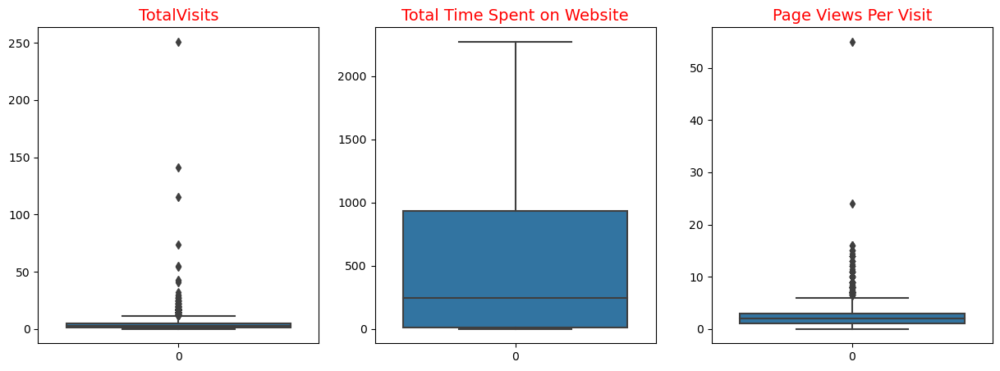

In [43]:
# Visualizing outliers in numerical columns after revision by excluding 'converted' which is a target variable

num_col_rev = ['TotalVisits', 'Total Time Spent on Website','Page Views Per Visit']

plt.figure(figsize = (15, 5))
for i, num_col_rev in enumerate(num_col_rev):
    plt.subplot(1,3, i+1)
    sns.boxplot(leads[num_col_rev])
    plt.title(num_col_rev, fontsize=14, color='red')
plt.show()

In [44]:
# Since there are outliers, looking for the quantile value information for capping
leads.describe([0.01,0.05, 0.25, 0.5, 0.75, 0.90, 0.95, 0.99])

,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit
count,9240.000000,9240.000000,9240.000000,9240.000000
mean,0.385390,3.438636,487.698268,2.357440
std,0.486714,4.819024,548.021466,2.145781
min,0.000000,0.000000,0.000000,0.000000
1%,0.000000,0.000000,0.000000,0.000000
5%,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,12.000000,1.000000
50%,0.000000,3.000000,248.000000,2.000000
75%,1.000000,5.000000,936.000000,3.000000
90%,1.000000,7.000000,1380.000000,5.000000


In [45]:
# Removing top 5% of the column Outlier values considering difference between 95% quantile and max value
# No capping done at bottom 5% as the value is same as min value for all columns

num_col_rev = ['TotalVisits', 'Total Time Spent on Website','Page Views Per Visit']

for col in num_col_rev:
    q1 = leads[col].quantile(0.00)
    q3 = leads[col].quantile(0.99)

    iqr = q3 - q1

    lower_bound = q1 -(1.5 * iqr) 
    upper_bound = q3 +(1.5 * iqr)

    leads = leads.loc[(leads[col] >= lower_bound) & (leads[col] <= upper_bound)]

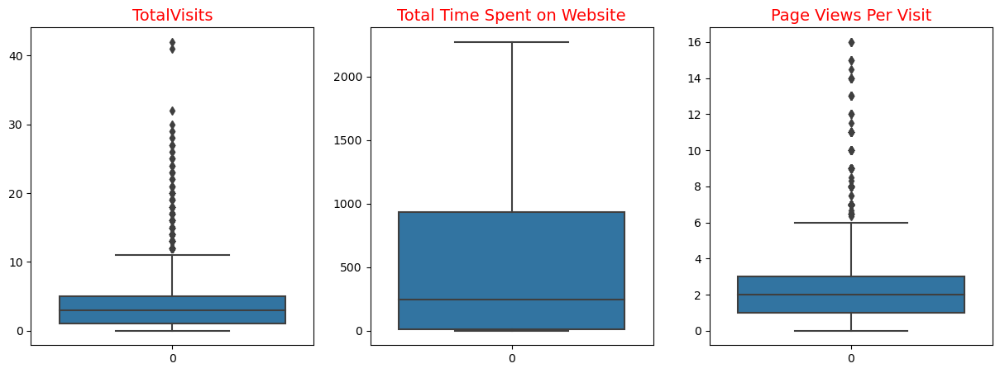

In [46]:
# Plotting for visualisation after outlier treatment

num_col_rev = ['TotalVisits', 'Total Time Spent on Website','Page Views Per Visit']

plt.figure(figsize = (15, 5))
for i, num_col_rev in enumerate(num_col_rev):
    plt.subplot(1,3, i+1)
    sns.boxplot(leads[num_col_rev])
    plt.title(num_col_rev, fontsize=14, color='red')
plt.show()

In [47]:
leads.shape

(9232, 25)

### Step 3: Exploratory Data Analysis

##### 'Converted' is the target variable which indicates whether a lead has been successfully converted or not. 
0: Not converted into lead & 1: Converted into lead.

In [48]:
# Checking for value count of target variable
leads.Converted.value_counts()

Converted
0    5673
1    3559
Name: count, dtype: int64

In [49]:
# Checking for overall conversion rate
(sum(leads['Converted'])/len(leads['Converted'].index))*100

38.55069324090121

In [50]:
leads.Converted.value_counts(normalize=True)

Converted
0    0.614493
1    0.385507
Name: proportion, dtype: float64

##### The lead conversion rate is around 39%

In [51]:
cat_col = leads.select_dtypes(include=['object']).columns
cat_col

Index(['Lead Origin', 'Lead Source', 'Do Not Email', 'Do Not Call',
       'Last Activity', 'Specialization', 'What is your current occupation',
       'Search', 'Magazine', 'Newspaper Article', 'X Education Forums',
       'Newspaper', 'Digital Advertisement', 'Through Recommendations',
       'Receive More Updates About Our Courses', 'Tags',
       'Update me on Supply Chain Content', 'Get updates on DM Content',
       'I agree to pay the amount through cheque',
       'A free copy of Mastering The Interview', 'Last Notable Activity'],
      dtype='object')

In [52]:
# To correct spelling error of Google
leads['Lead Source'] = leads['Lead Source'].replace(['google'], 'Google')

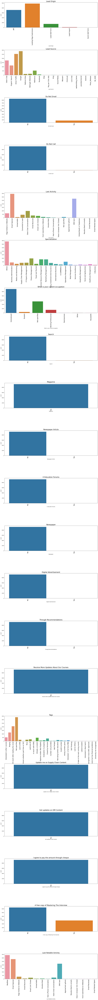

In [53]:
# Categorical column analysis

cat_col = ['Lead Origin', 'Lead Source', 'Do Not Email', 'Do Not Call','Last Activity', 'Specialization', 
           'What is your current occupation','Search', 'Magazine', 'Newspaper Article', 'X Education Forums','Newspaper', 
           'Digital Advertisement', 'Through Recommendations','Receive More Updates About Our Courses', 'Tags',
           'Update me on Supply Chain Content', 'Get updates on DM Content','I agree to pay the amount through cheque',
           'A free copy of Mastering The Interview', 'Last Notable Activity']

n_cols = 1
n_rows = (len(cat_col) + n_cols - 1) // n_cols  

plt.figure(figsize=(20, 10 * n_rows)) 

for i, col in enumerate(cat_col):
    plt.subplot(n_rows, n_cols, i + 1) 
    sns.countplot(data=leads, x=col)  
    plt.title(col, fontsize=20)  
    plt.xticks(rotation=90, fontsize=16)  

plt.subplots_adjust(hspace=0.9) 
plt.show()

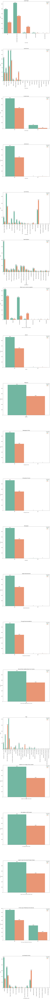

In [54]:
# Categorical column analysis with target variable

cat_col = ['Lead Origin', 'Lead Source', 'Do Not Email', 'Do Not Call','Last Activity', 'Specialization', 
           'What is your current occupation','Search', 'Magazine', 'Newspaper Article', 'X Education Forums','Newspaper', 
           'Digital Advertisement', 'Through Recommendations','Receive More Updates About Our Courses', 'Tags',
           'Update me on Supply Chain Content', 'Get updates on DM Content','I agree to pay the amount through cheque',
           'A free copy of Mastering The Interview', 'Last Notable Activity']

n_cols = 1 
n_rows = (len(cat_col) + n_cols - 1) // n_cols  
plt.figure(figsize=(15, 15 * n_rows)) 


for i, col in enumerate(cat_col):
    plt.subplot(n_rows, n_cols, i + 1) 
    ax=sns.countplot(x=col, hue='Converted', data=leads, palette='Set2')  
    plt.title(col, fontsize=14) 
    plt.xticks(rotation=90, fontsize=12)
    
    for p in ax.patches:
        ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2, p.get_height()),
                    ha='center', va='baseline', fontsize=11, color='black', xytext=(0, 5), textcoords='offset points')

plt.subplots_adjust(hspace=0.5) 
plt.show()

###### Inference:
1. Origin of the leads are maximum from 'API' and 'Landing Page Submission', but their conversion ratio is only 31% and 36% respectively. Whereas 'Lead Add Form' gives a good convertion rate of around 93%
2. 'Direct Traffic' and 'Google' are the source of highest number of leads. But 'Welingak Webiste' and 'Reference' shows the highest conversion rate of 99% and 92% respectively
3. 'Do not Email' & 'Do Not Call', which generates most of the leads, the highest number of the responses are 'No' 
4. Most leads have their 'Email opened' as last activity. But highest number of conversion, i.e., 63% are happening from 'SMS sent'
5. 'Management' specialization altogether have more number of leads. Conversion rates are mostly similar across different specializations.
6. 'Unemployed' persons submit higher number of leads, but conversion rate is only 44% . However, 'Working Professional' are easier to convert with highest conversion rate of 92% 
7. No much inference can be drawn from other categorical variables as most of the entries are 'No'

##### Based on the univariate analysis & data visualization, we can drop other categorical variables as they are not significant for analysis and will not add information to the model.

In [55]:
leads = leads.drop(['Magazine', 'Newspaper Article', 'X Education Forums','Newspaper', 
           'Digital Advertisement','Through Recommendations','Receive More Updates About Our Courses', 
           'Update me on Supply Chain Content', 'Get updates on DM Content','I agree to pay the amount through cheque', 'Tags'],axis=1)

In [56]:
cat_col = leads.select_dtypes(include=['object']).columns
cat_col

Index(['Lead Origin', 'Lead Source', 'Do Not Email', 'Do Not Call',
       'Last Activity', 'Specialization', 'What is your current occupation',
       'Search', 'A free copy of Mastering The Interview',
       'Last Notable Activity'],
      dtype='object')

In [57]:
num_col = leads.select_dtypes(include=['number']).columns
num_col

Index(['Converted', 'TotalVisits', 'Total Time Spent on Website',
       'Page Views Per Visit'],
      dtype='object')

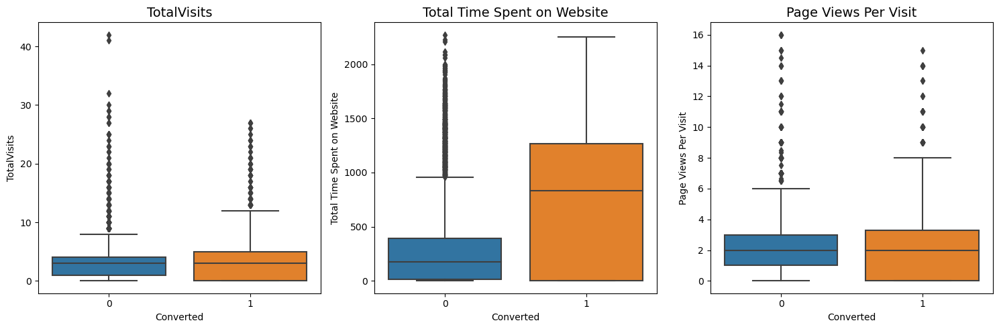

In [58]:
# Analysing numerical variables vs target variable

num_col= ['TotalVisits', 'Total Time Spent on Website', 'Page Views Per Visit']

plt.figure(figsize=(15, 5))
for i, var in enumerate(num_col):
    plt.subplot(1, 3, i + 1) 
    sns.boxplot(y=var, x='Converted', data=leads)
    plt.title(var, fontsize=14)

plt.tight_layout() 
plt.show()

##### Inference:
- The Conversion rates are higher for all 3 - 'Total Visits', 'Total Time Spent on Website' and 'Page Views Per Visit'
- 'TotalVisits' & 'Page Views Per Visit' have almost same median values for both outputs of leads. So, its inconclusive
- However, we can infer that people spending more time on the website are more likely to be converted. 

<Axes: >

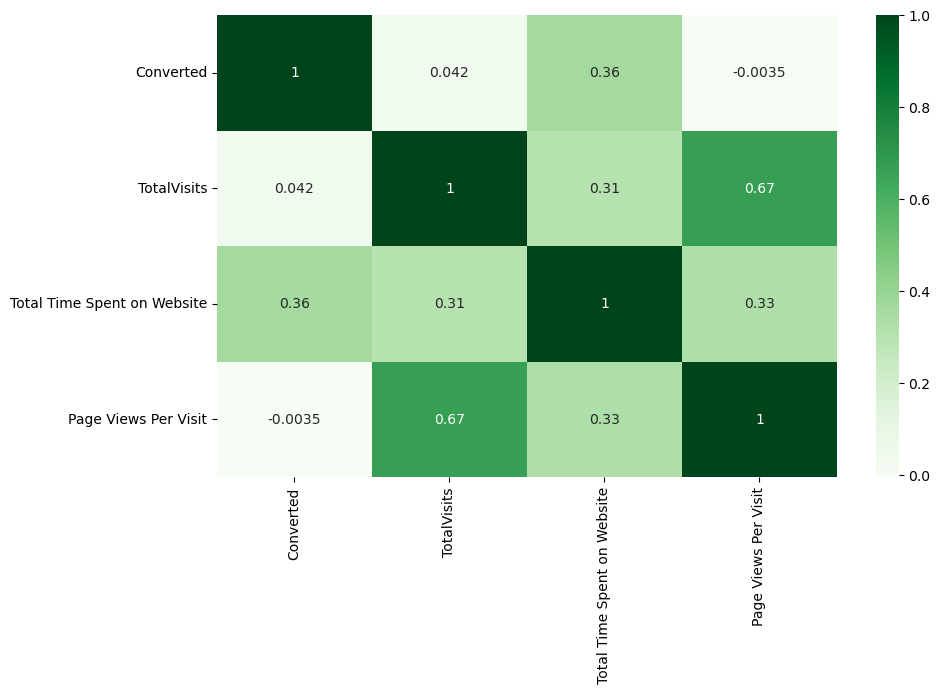

In [59]:
# Checking for correlation between numeric variables

cor_var=['Converted', 'TotalVisits', 'Total Time Spent on Website','Page Views Per Visit']
leads_cor = leads[cor_var]
plt.figure(figsize = (10,6))
sns.heatmap(leads_cor.corr(), cmap='Greens', annot=True)

##### Inference:

- We can observe a high correlation of 0.67 between 'TotalVisits' and 'Page Views per Visit'
- Among all numeric variables, Target variable 'Converted' has high correlation of 0.36 with 'Total Time Spent on Website'.
  This is relatable to the observation drawn from above boxplot
  

### Step 4: Data preparation for Logistic Regression

Logistic Regression data preparation: 
1) Creation of dummy variable 
2) Train and Test data split 
3) Variable scaling

##### 4.1 Creation of dummy variable

In [60]:
# Some of the categorical variables have Yes/No as responses. Converting them into 1s and 0s

binary =  ['Do Not Email', 'Do Not Call', 'Search', 'A free copy of Mastering The Interview']

def binary_map(x):
    return x.map({'Yes': 1, "No": 0})

leads[binary] = leads[binary].apply(binary_map)

In [61]:
leads.head()

,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Specialization,What is your current occupation,Search,A free copy of Mastering The Interview,Last Notable Activity
0,API,Olark Chat,0,0,0,0.0,0,0.0,Page Visited on Website,Others,Unemployed,0,0,Modified
1,API,Organic Search,0,0,0,5.0,674,2.5,Email Opened,Others,Unemployed,0,0,Email Opened
2,Landing Page Submission,Direct Traffic,0,0,1,2.0,1532,2.0,Email Opened,Business Administration,Student,0,1,Email Opened
3,Landing Page Submission,Direct Traffic,0,0,0,1.0,305,1.0,Unreachable,Media and Advertising,Unemployed,0,0,Modified
4,Landing Page Submission,Google,0,0,1,2.0,1428,1.0,Converted to Lead,Others,Unemployed,0,0,Modified


In [62]:
cat_col = leads.select_dtypes(include=['object']).columns
cat_col

Index(['Lead Origin', 'Lead Source', 'Last Activity', 'Specialization',
       'What is your current occupation', 'Last Notable Activity'],
      dtype='object')

In [63]:
# creating dummy variables for categorical columns

for_dummies=['Lead Origin', 'Lead Source', 'Last Activity', 'Specialization','What is your current occupation', 
             'Last Notable Activity']

dummies = pd.get_dummies(leads[for_dummies], drop_first=True)
dummies = dummies.astype(int)

# concat with original data set
leads = pd.concat([leads, dummies], axis = 1)

In [64]:
# Dropping the original columns after dummy creation
leads.drop(for_dummies, axis = 1, inplace = True)

In [65]:
leads.head()

,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Search,A free copy of Mastering The Interview,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Lead Origin_Quick Add Form,Lead Source_Direct Traffic,Lead Source_Facebook,Lead Source_Google,Lead Source_Live Chat,Lead Source_NC_EDM,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Pay per Click Ads,Lead Source_Press_Release,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Social Media,Lead Source_WeLearn,Lead Source_Welingak Website,Lead Source_bing,Lead Source_blog,Lead Source_testone,Lead Source_welearnblog_Home,Lead Source_youtubechannel,Last Activity_Converted to Lead,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Marked Spam,Last Activity_Email Opened,Last Activity_Email Received,Last Activity_Form Submitted on Website,Last Activity_Had a Phone Conversation,Last Activity_Not specified,Last Activity_Olark Chat Conversation,Last Activity_Page Visited on Website,Last Activity_Resubscribed to emails,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,Last Activity_View in browser link Clicked,Last Activity_Visited Booth in Tradeshow,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Others,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,What is your current occupation_Housewife,What is your current occupation_Not specified,What is your current occupation_Other,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional,Last Notable Activity_Email Bounced,Last Notable Activity_Email Link Clicked,Last Notable Activity_Email Marked Spam,Last Notable Activity_Email Opened,Last Notable Activity_Email Received,Last Notable Activity_Form Submitted on Website,Last Notable Activity_Had a Phone Conversation,Last Notable Activity_Modified,Last Notable Activity_Olark Chat Conversation,Last Notable Activity_Page Visited on Website,Last Notable Activity_Resubscribed to emails,Last Notable Activity_SMS Sent,Last Notable Activity_Unreachable,Last Notable Activity_Unsubscribed,Last Notable Activity_View in browser link Clicked
0,0,0,0,0.0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
1,0,0,0,5.0,674,2.5,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,0,0,1,2.0,1532,2.0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1.0,305,1.0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
4,0,0,1,2.0,1428,1.0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [66]:
leads.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9232 entries, 0 to 9239
Data columns (total 87 columns):
 #   Column                                                Non-Null Count  Dtype  
---  ------                                                --------------  -----  
 0   Do Not Email                                          9232 non-null   int64  
 1   Do Not Call                                           9232 non-null   int64  
 2   Converted                                             9232 non-null   int64  
 3   TotalVisits                                           9232 non-null   float64
 4   Total Time Spent on Website                           9232 non-null   int64  
 5   Page Views Per Visit                                  9232 non-null   float64
 6   Search                                                9232 non-null   int64  
 7   A free copy of Mastering The Interview                9232 non-null   int64  
 8   Lead Origin_Landing Page Submission                   9232 non-

In [67]:
leads.shape

(9232, 87)

###### 4.2 Train and Test data split

In [68]:
# Creating X and y
y = leads["Converted"]
X = leads.drop("Converted",axis=1)

In [69]:
X.shape,y.shape

((9232, 86), (9232,))

In [70]:
# Splitting to train and test dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

In [71]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((6462, 86), (2770, 86), (6462,), (2770,))

##### 4.3 Variable scaling

In [72]:
# Using StandardScaler for rescaling the features

scaler = StandardScaler()

In [73]:
# Applying scaler to all numeric columns

num_col = ['Do Not Email', 'Do Not Call', 'TotalVisits','Total Time Spent on Website', 'Page Views Per Visit', 
           'Search','A free copy of Mastering The Interview']

# For the training data, both Fit and Transform needs to be done.
X_train[num_col]=scaler.fit_transform(X_train[num_col])


In [74]:
X_train.head()

,Do Not Email,Do Not Call,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Search,A free copy of Mastering The Interview,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Lead Origin_Quick Add Form,Lead Source_Direct Traffic,Lead Source_Facebook,Lead Source_Google,Lead Source_Live Chat,Lead Source_NC_EDM,Lead Source_Olark Chat,Lead Source_Organic Search,Lead Source_Pay per Click Ads,Lead Source_Press_Release,Lead Source_Reference,Lead Source_Referral Sites,Lead Source_Social Media,Lead Source_WeLearn,Lead Source_Welingak Website,Lead Source_bing,Lead Source_blog,Lead Source_testone,Lead Source_welearnblog_Home,Lead Source_youtubechannel,Last Activity_Converted to Lead,Last Activity_Email Bounced,Last Activity_Email Link Clicked,Last Activity_Email Marked Spam,Last Activity_Email Opened,Last Activity_Email Received,Last Activity_Form Submitted on Website,Last Activity_Had a Phone Conversation,Last Activity_Not specified,Last Activity_Olark Chat Conversation,Last Activity_Page Visited on Website,Last Activity_Resubscribed to emails,Last Activity_SMS Sent,Last Activity_Unreachable,Last Activity_Unsubscribed,Last Activity_View in browser link Clicked,Last Activity_Visited Booth in Tradeshow,Specialization_Business Administration,Specialization_E-Business,Specialization_E-COMMERCE,Specialization_Finance Management,Specialization_Healthcare Management,Specialization_Hospitality Management,Specialization_Human Resource Management,Specialization_IT Projects Management,Specialization_International Business,Specialization_Marketing Management,Specialization_Media and Advertising,Specialization_Operations Management,Specialization_Others,Specialization_Retail Management,Specialization_Rural and Agribusiness,Specialization_Services Excellence,Specialization_Supply Chain Management,Specialization_Travel and Tourism,What is your current occupation_Housewife,What is your current occupation_Not specified,What is your current occupation_Other,What is your current occupation_Student,What is your current occupation_Unemployed,What is your current occupation_Working Professional,Last Notable Activity_Email Bounced,Last Notable Activity_Email Link Clicked,Last Notable Activity_Email Marked Spam,Last Notable Activity_Email Opened,Last Notable Activity_Email Received,Last Notable Activity_Form Submitted on Website,Last Notable Activity_Had a Phone Conversation,Last Notable Activity_Modified,Last Notable Activity_Olark Chat Conversation,Last Notable Activity_Page Visited on Website,Last Notable Activity_Resubscribed to emails,Last Notable Activity_SMS Sent,Last Notable Activity_Unreachable,Last Notable Activity_Unsubscribed,Last Notable Activity_View in browser link Clicked
1032,-0.292409,-0.017595,0.772665,1.622397,1.775608,-0.039369,-0.672410,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
6557,-0.292409,-0.017595,0.189852,1.298157,-0.169944,-0.039369,1.487188,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
4310,-0.292409,-0.017595,-0.101555,-0.572594,-0.413138,-0.039369,-0.672410,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3191,-0.292409,-0.017595,0.189852,0.349120,0.802832,-0.039369,-0.672410,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
712,-0.292409,-0.017595,-0.684368,-0.610847,-0.656332,-0.039369,-0.672410,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [75]:
# Re-checking the conversion rate
(sum(leads['Converted'])/len(leads['Converted'].index))*100

38.55069324090121

##### Conversion rate is around 39% . This is neither exactly 'balanced' nor heavily imbalanced. Hence we will not do any special treatment for this dataset.

### Step 5 : Building a Logistic Model

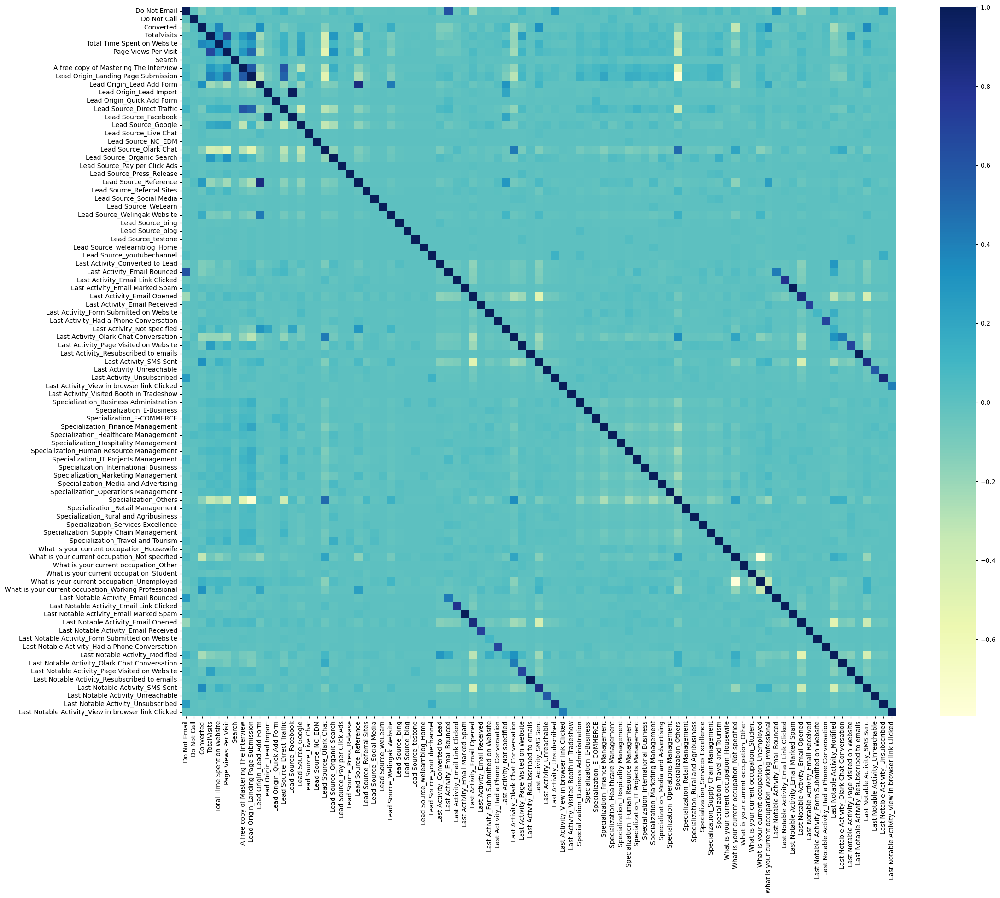

In [76]:
# Looking at the correlation table
plt.figure(figsize=(25, 20))
sns.heatmap(leads.corr(), cmap='YlGnBu')
plt.show()

###### Building a model:
Since there are a lot of variables present in the dataset, will select a small set of features using RFE.
1. Building a Logistic Regression model using RFE
2. Building a model using selected features

##### 5.1 RFE : Building logistic regression model through RFE

In [77]:
lg = LogisticRegression()

In [78]:
#Selecting 15 features through automated approach

rfe = RFE(estimator=lg, n_features_to_select=15)           
rfe = rfe.fit(X_train, y_train)

In [79]:
#List of variables selected in top 15 list. Sorted by ranking for easy visualisation

rfe_sel=pd.DataFrame({'Feature': X_train.columns, 'Select Status': rfe.support_, 'Ranking': rfe.ranking_})
rfe_sel.sort_values(by='Ranking')

,Feature,Select Status,Ranking
42,Last Activity_SMS Sent,True,1
70,What is your current occupation_Working Profes...,True,1
65,What is your current occupation_Housewife,True,1
16,Lead Source_Olark Chat,True,1
24,Lead Source_Welingak Website,True,1
30,Last Activity_Converted to Lead,True,1
66,What is your current occupation_Not specified,True,1
77,Last Notable Activity_Had a Phone Conversation,True,1
31,Last Activity_Email Bounced,True,1
38,Last Activity_Not specified,True,1


In [80]:
# Listing the columns selected by RFE. These columns can be considered as a start for manual elimination

sel_col=X_train.columns[rfe.support_]
sel_col


Index(['Total Time Spent on Website', 'Lead Origin_Lead Add Form',
       'Lead Source_Olark Chat', 'Lead Source_Welingak Website',
       'Last Activity_Converted to Lead', 'Last Activity_Email Bounced',
       'Last Activity_Not specified', 'Last Activity_Olark Chat Conversation',
       'Last Activity_SMS Sent', 'What is your current occupation_Housewife',
       'What is your current occupation_Not specified',
       'What is your current occupation_Working Professional',
       'Last Notable Activity_Had a Phone Conversation',
       'Last Notable Activity_Resubscribed to emails',
       'Last Notable Activity_Unreachable'],
      dtype='object')

In [81]:
# Features not selected by RFE

X_train.columns[~rfe.support_]

Index(['Do Not Email', 'Do Not Call', 'TotalVisits', 'Page Views Per Visit',
       'Search', 'A free copy of Mastering The Interview',
       'Lead Origin_Landing Page Submission', 'Lead Origin_Lead Import',
       'Lead Origin_Quick Add Form', 'Lead Source_Direct Traffic',
       'Lead Source_Facebook', 'Lead Source_Google', 'Lead Source_Live Chat',
       'Lead Source_NC_EDM', 'Lead Source_Organic Search',
       'Lead Source_Pay per Click Ads', 'Lead Source_Press_Release',
       'Lead Source_Reference', 'Lead Source_Referral Sites',
       'Lead Source_Social Media', 'Lead Source_WeLearn', 'Lead Source_bing',
       'Lead Source_blog', 'Lead Source_testone',
       'Lead Source_welearnblog_Home', 'Lead Source_youtubechannel',
       'Last Activity_Email Link Clicked', 'Last Activity_Email Marked Spam',
       'Last Activity_Email Opened', 'Last Activity_Email Received',
       'Last Activity_Form Submitted on Website',
       'Last Activity_Had a Phone Conversation',
       'Last 

In [82]:
# Creating X_train dataframe with RFE selected variables

X_train_rfe = X_train[sel_col]

In [83]:
# Creation of dataframe for all the feature variables and their respective VIFs

vif = pd.DataFrame()
vif['Features'] = X_train_rfe.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe.values, i) for i in range(X_train_rfe.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
2,Lead Source_Olark Chat,1.64
1,Lead Origin_Lead Add Form,1.61
7,Last Activity_Olark Chat Conversation,1.40
10,What is your current occupation_Not specified,1.32
3,Lead Source_Welingak Website,1.28
0,Total Time Spent on Website,1.25
8,Last Activity_SMS Sent,1.24
11,What is your current occupation_Working Profes...,1.16
6,Last Activity_Not specified,1.15
4,Last Activity_Converted to Lead,1.02


##### 5.2 Building a model using RFE selected features

###### 1st model

In [84]:
# Adding a constant first
X_train_sm = sm.add_constant(X_train_rfe)

In [85]:
# Creating the Model
lg = sm.GLM(y_train, X_train_sm,family = sm.families.Binomial())

# Fitting the Model
lg_model = lg.fit()

In [86]:
# Printing the summary of the logistic regression model obtained
print(lg_model.summary())
print("**********************************************************************************************")
print(vif)

                 Generalized Linear Model Regression Results                  
Dep. Variable:              Converted   No. Observations:                 6462
Model:                            GLM   Df Residuals:                     6446
Model Family:                Binomial   Df Model:                           15
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -2653.0
Date:                Thu, 17 Oct 2024   Deviance:                       5305.9
Time:                        01:46:04   Pearson chi2:                 6.57e+03
No. Iterations:                    21   Pseudo R-squ. (CS):             0.4033
Covariance Type:            nonrobust                                         
                                                           coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------

###### 2nd model

In [87]:
# In the 1st model, the p values of 'Last Notable Activity_Resubscribed to emails' is high. Hence we will drop this column

sel_col = sel_col.drop(['Last Notable Activity_Resubscribed to emails'])
X_train_rfe = X_train[sel_col]

In [88]:
X_train_rfe

,Total Time Spent on Website,Lead Origin_Lead Add Form,Lead Source_Olark Chat,Lead Source_Welingak Website,Last Activity_Converted to Lead,Last Activity_Email Bounced,Last Activity_Not specified,Last Activity_Olark Chat Conversation,Last Activity_SMS Sent,What is your current occupation_Housewife,What is your current occupation_Not specified,What is your current occupation_Working Professional,Last Notable Activity_Had a Phone Conversation,Last Notable Activity_Unreachable
1032,1.622397,0,0,0,0,0,0,0,1,0,0,0,0,0
6557,1.298157,0,0,0,0,0,0,0,1,0,0,0,0,0
4310,-0.572594,0,1,0,0,0,0,0,1,0,0,0,0,0
3191,0.349120,0,0,0,0,0,0,0,0,0,0,0,0,0
712,-0.610847,0,0,0,1,0,0,0,0,0,0,0,0,0
3942,0.451128,0,0,0,0,0,0,0,1,0,0,0,0,0
6808,-0.885904,0,1,0,0,0,0,0,0,0,1,0,0,0
9206,1.609646,0,0,0,0,0,0,0,1,0,0,0,0,0
4698,-0.798469,0,0,0,0,0,0,0,0,0,0,0,0,0
6563,-0.885904,0,1,0,0,0,0,0,0,0,0,0,0,0


In [89]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe.values, i) for i in range(X_train_rfe.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
2,Lead Source_Olark Chat,1.64
1,Lead Origin_Lead Add Form,1.61
7,Last Activity_Olark Chat Conversation,1.40
10,What is your current occupation_Not specified,1.32
3,Lead Source_Welingak Website,1.28
0,Total Time Spent on Website,1.25
8,Last Activity_SMS Sent,1.24
11,What is your current occupation_Working Profes...,1.16
6,Last Activity_Not specified,1.15
4,Last Activity_Converted to Lead,1.02


In [90]:
X_train_sm = sm.add_constant(X_train_rfe)
lg = sm.GLM(y_train, X_train_sm,family = sm.families.Binomial())
lg_model = lg.fit()
print(lg_model.summary())
print("**********************************************************************************************")
print(vif)

                 Generalized Linear Model Regression Results                  
Dep. Variable:              Converted   No. Observations:                 6462
Model:                            GLM   Df Residuals:                     6447
Model Family:                Binomial   Df Model:                           14
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -2655.0
Date:                Thu, 17 Oct 2024   Deviance:                       5310.1
Time:                        01:46:07   Pearson chi2:                 6.57e+03
No. Iterations:                    21   Pseudo R-squ. (CS):             0.4029
Covariance Type:            nonrobust                                         
                                                           coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------

###### 3rd Model

In [91]:
# In the 2nd model, all the p values are significant (<0.05). Let us drop 'Last Notable Activity_Had a Phone Conversation'
# for better fine tuning

sel_col = sel_col.drop(['Last Notable Activity_Had a Phone Conversation'])
X_train_rfe = X_train[sel_col]

In [92]:
X_train_rfe

,Total Time Spent on Website,Lead Origin_Lead Add Form,Lead Source_Olark Chat,Lead Source_Welingak Website,Last Activity_Converted to Lead,Last Activity_Email Bounced,Last Activity_Not specified,Last Activity_Olark Chat Conversation,Last Activity_SMS Sent,What is your current occupation_Housewife,What is your current occupation_Not specified,What is your current occupation_Working Professional,Last Notable Activity_Unreachable
1032,1.622397,0,0,0,0,0,0,0,1,0,0,0,0
6557,1.298157,0,0,0,0,0,0,0,1,0,0,0,0
4310,-0.572594,0,1,0,0,0,0,0,1,0,0,0,0
3191,0.349120,0,0,0,0,0,0,0,0,0,0,0,0
712,-0.610847,0,0,0,1,0,0,0,0,0,0,0,0
3942,0.451128,0,0,0,0,0,0,0,1,0,0,0,0
6808,-0.885904,0,1,0,0,0,0,0,0,0,1,0,0
9206,1.609646,0,0,0,0,0,0,0,1,0,0,0,0
4698,-0.798469,0,0,0,0,0,0,0,0,0,0,0,0
6563,-0.885904,0,1,0,0,0,0,0,0,0,0,0,0


In [93]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe.values, i) for i in range(X_train_rfe.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
2,Lead Source_Olark Chat,1.64
1,Lead Origin_Lead Add Form,1.61
7,Last Activity_Olark Chat Conversation,1.40
10,What is your current occupation_Not specified,1.32
3,Lead Source_Welingak Website,1.28
0,Total Time Spent on Website,1.25
8,Last Activity_SMS Sent,1.24
11,What is your current occupation_Working Profes...,1.16
6,Last Activity_Not specified,1.15
4,Last Activity_Converted to Lead,1.02


In [94]:
X_train_sm = sm.add_constant(X_train_rfe)
lg = sm.GLM(y_train, X_train_sm,family = sm.families.Binomial())
lg_model = lg.fit()
print(lg_model.summary())
print("**********************************************************************************************")
print(vif)

                 Generalized Linear Model Regression Results                  
Dep. Variable:              Converted   No. Observations:                 6462
Model:                            GLM   Df Residuals:                     6448
Model Family:                Binomial   Df Model:                           13
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -2658.8
Date:                Thu, 17 Oct 2024   Deviance:                       5317.7
Time:                        01:46:10   Pearson chi2:                 6.58e+03
No. Iterations:                    21   Pseudo R-squ. (CS):             0.4022
Covariance Type:            nonrobust                                         
                                                           coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------

###### 4th Model

In [95]:
# In the 3rd model, P value of 'What is your current occupation_Housewife' is high. Let us drop this column
sel_col = sel_col.drop(['What is your current occupation_Housewife'])
X_train_rfe = X_train[sel_col]

In [96]:
X_train_rfe 

,Total Time Spent on Website,Lead Origin_Lead Add Form,Lead Source_Olark Chat,Lead Source_Welingak Website,Last Activity_Converted to Lead,Last Activity_Email Bounced,Last Activity_Not specified,Last Activity_Olark Chat Conversation,Last Activity_SMS Sent,What is your current occupation_Not specified,What is your current occupation_Working Professional,Last Notable Activity_Unreachable
1032,1.622397,0,0,0,0,0,0,0,1,0,0,0
6557,1.298157,0,0,0,0,0,0,0,1,0,0,0
4310,-0.572594,0,1,0,0,0,0,0,1,0,0,0
3191,0.349120,0,0,0,0,0,0,0,0,0,0,0
712,-0.610847,0,0,0,1,0,0,0,0,0,0,0
3942,0.451128,0,0,0,0,0,0,0,1,0,0,0
6808,-0.885904,0,1,0,0,0,0,0,0,1,0,0
9206,1.609646,0,0,0,0,0,0,0,1,0,0,0
4698,-0.798469,0,0,0,0,0,0,0,0,0,0,0
6563,-0.885904,0,1,0,0,0,0,0,0,0,0,0


In [97]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe.values, i) for i in range(X_train_rfe.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
2,Lead Source_Olark Chat,1.64
1,Lead Origin_Lead Add Form,1.60
7,Last Activity_Olark Chat Conversation,1.40
9,What is your current occupation_Not specified,1.32
3,Lead Source_Welingak Website,1.27
0,Total Time Spent on Website,1.25
8,Last Activity_SMS Sent,1.24
10,What is your current occupation_Working Profes...,1.16
6,Last Activity_Not specified,1.15
4,Last Activity_Converted to Lead,1.02


In [98]:
X_train_sm = sm.add_constant(X_train_rfe)
lg = sm.GLM(y_train, X_train_sm,family = sm.families.Binomial())
lg_model = lg.fit()
print(lg_model.summary())
print("**********************************************************************************************")
print(vif)

                 Generalized Linear Model Regression Results                  
Dep. Variable:              Converted   No. Observations:                 6462
Model:                            GLM   Df Residuals:                     6449
Model Family:                Binomial   Df Model:                           12
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -2663.1
Date:                Thu, 17 Oct 2024   Deviance:                       5326.3
Time:                        01:46:12   Pearson chi2:                 6.59e+03
No. Iterations:                     7   Pseudo R-squ. (CS):             0.4014
Covariance Type:            nonrobust                                         
                                                           coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------

### We will stop at the 4th Model as we observe P values of all variables are almost 0 and VIF is less than 2


### Step 6 : Model Evaluation

In [99]:
# Prediction of training set

y_train_pred = lg_model.predict(X_train_sm)
y_train_pred.head(10)

1032    0.867866
6557    0.820237
4310    0.690130
3191    0.343372
712     0.045108
3942    0.637920
6808    0.123878
9206    0.866215
4698    0.125915
6563    0.342694
dtype: float64

In [100]:
# Reshaping to an array

y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

array([0.86786595, 0.82023651, 0.6901301 , 0.34337191, 0.04510806,
       0.63791992, 0.12387788, 0.86621454, 0.12591477, 0.3426938 ])

In [101]:
# Creating a dataframe to compare actual converted flag and the predicted probabilities

y_train_pred_final = pd.DataFrame({'Converted':y_train.values, 'Converted_prob':y_train_pred})
y_train_pred_final['Lead_ID'] = y_train.index
y_train_pred_final.head()

,Converted,Converted_prob,Lead_ID
0,1,0.867866,1032
1,1,0.820237,6557
2,0,0.690130,4310
3,0,0.343372,3191
4,0,0.045108,712


##### Selecting an arbitrary cut-off probability point of 0.5 to find the predicted labels¶

In [102]:
# Creating a new column 'predicted' with 1 if Converted_Prob > 0.5 else 0

y_train_pred_final['Predicted'] = y_train_pred_final.Converted_prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,Converted,Converted_prob,Lead_ID,Predicted
0,1,0.867866,1032,1
1,1,0.820237,6557,1
2,0,0.690130,4310,1
3,0,0.343372,3191,0
4,0,0.045108,712,0


###### Confusion matrix and accuracy check

In [103]:
confusion = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.Predicted )
print(confusion)

[[3489  453]
 [ 735 1785]]


In [104]:
# Accuracy
print(metrics.accuracy_score(y_train_pred_final.Converted, y_train_pred_final.Predicted))

0.8161559888579387


##### Accuracy is around 82% which is good. However we need to look at other metrics as we cannot depend on accuracy alone

In [105]:
# Evaluating other metrics

TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [106]:
sensitivity = TP/float(TP+FN)
specificity = TN/float(TN+FP)
precision = TP/float(TP+FP)
accuracy = float(TP+TN)/float(TP+FP+TN+FN)
    
print("Accuracy: ", round(accuracy,3))
print("Sensitivity: ", round(sensitivity,3))
print("Specificity: ", round(specificity,3))
print("Precision: ", round(precision,3))

Accuracy:  0.816
Sensitivity:  0.708
Specificity:  0.885
Precision:  0.798


##### All the metrics are above 80% except for Sensitivity which is 71%. This may be due to arbitrarily chosen cut-off of 0.5. Using ROC curve, will optimize the cut-off point for a better Sensitivity

### Step 7 : Drawing ROC Curve

In [107]:
# Function for drawing ROC curve

def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return None

In [108]:
fpr, tpr, thresholds = metrics.roc_curve( y_train_pred_final.Converted, y_train_pred_final.Converted_prob, drop_intermediate = False )

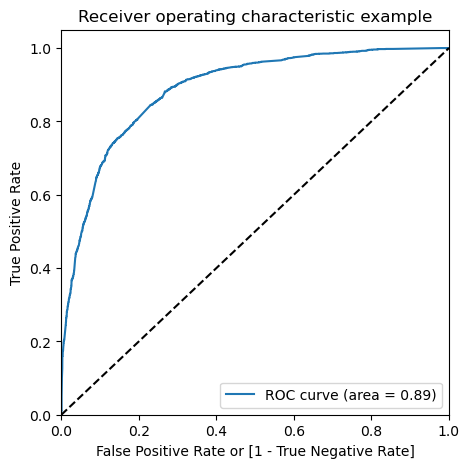

In [109]:
draw_roc(y_train_pred_final.Converted, y_train_pred_final.Converted_prob)

##### The area under the curve of the ROC is 0.89 which is quite good and hence the model seems to be good. Need to also check the sensitivity and specificity tradeoff to find the optimal cutoff point.

### Step 8 : Finding Optimal Cutoff Point

In [110]:
cut_off = [float(x)/10 for x in range(10)]
for i in cut_off:
    y_train_pred_final[i]= y_train_pred_final.Converted_prob.map(lambda x: 1 if x > i else 0)
y_train_pred_final.head()

,Converted,Converted_prob,Lead_ID,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,1,0.867866,1032,1,1,1,1,1,1,1,1,1,1,0
1,1,0.820237,6557,1,1,1,1,1,1,1,1,1,1,0
2,0,0.690130,4310,1,1,1,1,1,1,1,1,0,0,0
3,0,0.343372,3191,0,1,1,1,1,0,0,0,0,0,0
4,0,0.045108,712,0,1,0,0,0,0,0,0,0,0,0


In [111]:
# Calculating accuracy sensitivity and specificity for various probability cutoffs.

cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensitivity','specificity'])

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    specificity = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensitivity = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensitivity,specificity]
print(cutoff_df)

     prob  accuracy  sensitivity  specificity
0.0   0.0  0.389972     1.000000     0.000000
0.1   0.1  0.597493     0.982143     0.351598
0.2   0.2  0.757815     0.922222     0.652714
0.3   0.3  0.789075     0.864683     0.740741
0.4   0.4  0.811049     0.768651     0.838153
0.5   0.5  0.816156     0.708333     0.885084
0.6   0.6  0.806561     0.644841     0.909944
0.7   0.7  0.778706     0.524206     0.941400
0.8   0.8  0.755494     0.430159     0.963470
0.9   0.9  0.708140     0.273016     0.986301


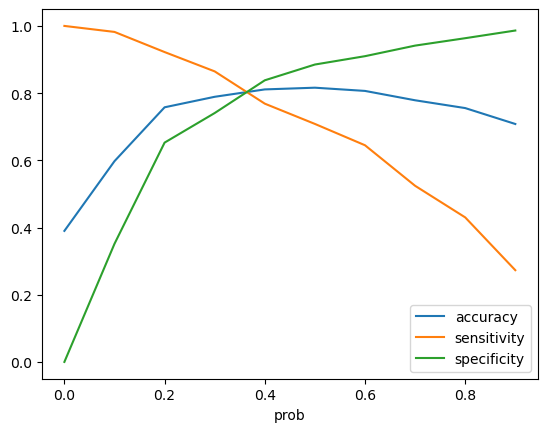

In [112]:
# Plotting accuracy sensitivity and specificity for various probabilities.
cutoff_df.plot.line(x='prob', y=['accuracy','sensitivity','specificity'])
plt.show()

##### From the curve, 0.37 looks the optimum cutoff probability. However, will re-confim the exact value by drawing a line passing through it

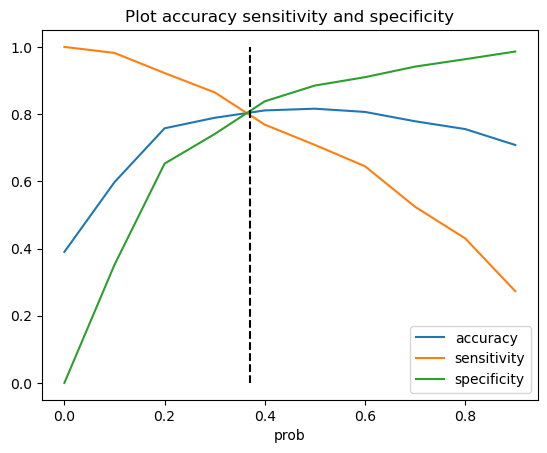

In [113]:
cutoff_df.plot.line(x='prob', y=['accuracy','sensitivity','specificity'])
plt.vlines(x=0.37, ymax=1, ymin=0.0, colors="black", linestyles="--")
plt.title("Plot accuracy sensitivity and specificity")
plt.show()

In [114]:
# Using 0.37 cut-off for final predictions
y_train_pred_final['Final_predicted'] = y_train_pred_final.Converted_prob.map( lambda x: 1 if x > 0.37 else 0)
y_train_pred_final.head()

,Converted,Converted_prob,Lead_ID,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,Final_predicted
0,1,0.867866,1032,1,1,1,1,1,1,1,1,1,1,0,1
1,1,0.820237,6557,1,1,1,1,1,1,1,1,1,1,0,1
2,0,0.690130,4310,1,1,1,1,1,1,1,1,0,0,0,1
3,0,0.343372,3191,0,1,1,1,1,0,0,0,0,0,0,0
4,0,0.045108,712,0,1,0,0,0,0,0,0,0,0,0,0


In [115]:
# Checking for all the metrcis again
metrics.accuracy_score(y_train_pred_final.Converted, y_train_pred_final.Final_predicted)

0.807799442896936

In [116]:
# Confusion metrics

confusion = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.Final_predicted)
print(confusion)

[[3236  706]
 [ 536 1984]]


In [117]:
# Evaluating other metrics

TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [118]:
sensitivity = TP/float(TP+FN)
specificity = TN/float(TN+FP)
precision = TP/float(TP+FP)
accuracy = float(TP+TN)/float(TP+FP+TN+FN)
    
print("Accuracy: ", round(accuracy,3))
print("Sensitivity: ", round(sensitivity,3))
print("Specificity: ", round(specificity,3))
print("Precision: ", round(precision,3))

Accuracy:  0.808
Sensitivity:  0.787
Specificity:  0.821
Precision:  0.738


##### Sensitivity of the model is now 79%

In [119]:
# Calculate the lead score

y_train_pred_final['lead_score'] = y_train_pred_final.Converted_prob.map(lambda x: round(x*100))
y_train_pred_final.head(20)

,Converted,Converted_prob,Lead_ID,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,Final_predicted,lead_score
0,1,0.867866,1032,1,1,1,1,1,1,1,1,1,1,0,1,87
1,1,0.820237,6557,1,1,1,1,1,1,1,1,1,1,0,1,82
2,0,0.690130,4310,1,1,1,1,1,1,1,1,0,0,0,1,69
3,0,0.343372,3191,0,1,1,1,1,0,0,0,0,0,0,0,34
4,0,0.045108,712,0,1,0,0,0,0,0,0,0,0,0,0,5
5,1,0.637920,3942,1,1,1,1,1,1,1,1,0,0,0,1,64
6,0,0.123878,6808,0,1,1,0,0,0,0,0,0,0,0,0,12
7,0,0.866215,9206,1,1,1,1,1,1,1,1,1,1,0,1,87
8,0,0.125915,4698,0,1,1,0,0,0,0,0,0,0,0,0,13
9,0,0.342694,6563,0,1,1,1,1,0,0,0,0,0,0,0,34


In [120]:
# checking if 80% cases are correctly predicted based on the converted column.
checking = y_train_pred_final.loc[y_train_pred_final['Converted']==1,['Converted','Final_predicted']]
checking ['Final_predicted'].value_counts()

Final_predicted
1    1984
0     536
Name: count, dtype: int64

In [121]:
# Checking the % of Final_predicted conversions

1984/float(1984+536)

0.7873015873015873

###### Precision and Recall Tradeoff

In [122]:
y_train_pred_final.Converted, y_train_pred_final.Predicted

(0       1
 1       1
 2       0
 3       0
 4       0
 5       1
 6       0
 7       0
 8       0
 9       0
 10      0
 11      1
 12      0
 13      0
 14      0
 15      0
 16      0
 17      1
 18      1
 19      0
 20      1
 21      0
 22      0
 23      0
 24      0
 25      0
 26      0
 27      0
 28      1
 29      0
 30      1
 31      0
 32      0
 33      1
 34      0
 35      0
 36      1
 37      1
 38      0
 39      0
 40      1
 41      1
 42      1
 43      0
 44      1
 45      0
 46      0
 47      0
 48      0
 49      0
 50      0
 51      0
 52      1
 53      0
 54      1
 55      0
 56      0
 57      1
 58      1
 59      0
 60      0
 61      0
 62      0
 63      0
 64      1
 65      0
 66      0
 67      0
 68      0
 69      0
 70      0
 71      0
 72      0
 73      0
 74      1
 75      1
 76      0
 77      0
 78      1
 79      1
 80      1
 81      0
 82      0
 83      0
 84      1
 85      0
 86      0
 87      1
 88      1
 89      1
 90      0

In [123]:
p, r, thresholds = precision_recall_curve(y_train_pred_final.Converted, y_train_pred_final.Converted_prob)

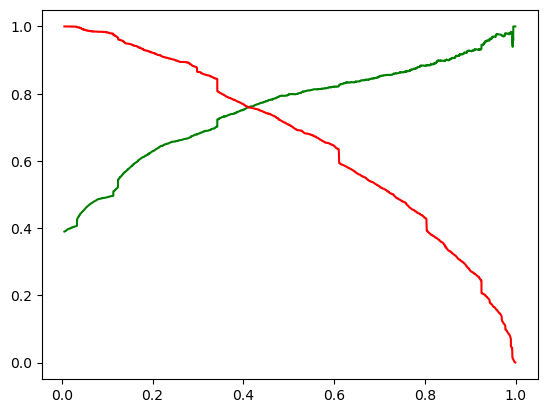

In [124]:
# plotting a trade-off curve between precision and recall
plt.plot(thresholds, p[:-1], "g-")
plt.plot(thresholds, r[:-1], "r-")
plt.show()

##### Curve shows 0.40 as the optimum cutoff probability using Precision-Recall. We can check our accuracy using this cutoff too.

In [125]:
# Using 0.40 threshold for predictions
y_train_pred_final['Final_predicted_rev'] = y_train_pred_final.Converted_prob.map(lambda x: 1 if x > 0.40 else 0)
y_train_pred_final.head()

,Converted,Converted_prob,Lead_ID,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,Final_predicted,lead_score,Final_predicted_rev
0,1,0.867866,1032,1,1,1,1,1,1,1,1,1,1,0,1,87,1
1,1,0.820237,6557,1,1,1,1,1,1,1,1,1,1,0,1,82,1
2,0,0.690130,4310,1,1,1,1,1,1,1,1,0,0,0,1,69,1
3,0,0.343372,3191,0,1,1,1,1,0,0,0,0,0,0,0,34,0
4,0,0.045108,712,0,1,0,0,0,0,0,0,0,0,0,0,5,0


In [126]:
# Confusion metrics

confusion = metrics.confusion_matrix(y_train_pred_final.Converted, y_train_pred_final.Final_predicted_rev)
print(confusion)

[[3304  638]
 [ 583 1937]]


In [127]:
sensitivity = TP/float(TP+FN)
specificity = TN/float(TN+FP)
precision = TP/float(TP+FP)
accuracy = float(TP+TN)/float(TP+FP+TN+FN)
    
print("Accuracy: ", round(accuracy,3))
print("Sensitivity: ", round(sensitivity,3))
print("Specificity: ", round(specificity,3))
print("Precision: ", round(precision,3))

Accuracy:  0.808
Sensitivity:  0.787
Specificity:  0.821
Precision:  0.738


##### Since metrics yield similar results for both 0.37 and 0.40 cut-offs, we will retain the cut-off of 0.37 for predictions on the test set.

### Step 9 : Predictions on the Test set

In [128]:
# Feature transform on the test set
num_col = ['Do Not Email', 'Do Not Call', 'TotalVisits','Total Time Spent on Website', 'Page Views Per Visit', 
           'Search','A free copy of Mastering The Interview']
X_test[num_col] = scaler.fit_transform(X_test[num_col])

In [129]:
# Assigning the columns selected by the final model to the X_test 
X_test = X_test[sel_col]
X_test.head()

,Total Time Spent on Website,Lead Origin_Lead Add Form,Lead Source_Olark Chat,Lead Source_Welingak Website,Last Activity_Converted to Lead,Last Activity_Email Bounced,Last Activity_Not specified,Last Activity_Olark Chat Conversation,Last Activity_SMS Sent,What is your current occupation_Not specified,What is your current occupation_Working Professional,Last Notable Activity_Unreachable
4869,1.522635,0,0,0,0,0,0,0,0,0,1,0
8687,1.749932,0,0,0,0,0,0,0,1,0,0,0
6309,-0.898806,1,0,1,0,0,0,0,1,0,0,0
8158,-0.898806,0,1,0,0,0,0,0,0,0,0,0
2509,0.897570,0,0,0,0,0,0,0,1,0,0,0


In [130]:
# Adding constant variable to test dataframe
X_test_sm = sm.add_constant(X_test)

In [131]:
# Making predictions on the test set
y_test_pred = lg_model.predict(X_test_sm)
y_test_pred[:10]

4869    0.953295
8687    0.883449
6309    0.989326
8158    0.339436
2509    0.744199
7812    0.364178
435     0.186696
7843    0.351955
5442    0.484400
2307    0.914192
dtype: float64

In [132]:
# Converting y_pred to a dataframe which is an array
y_pred_df = pd.DataFrame(y_test_pred)
y_pred_df.head()

,0
4869,0.953295
8687,0.883449
6309,0.989326
8158,0.339436
2509,0.744199


In [133]:
# Converting y_test to dataframe
y_test_df = pd.DataFrame(y_test)
y_test_df.head()

,Converted
4869,1
8687,1
6309,1
8158,1
2509,1


In [134]:
# Assigning Lead ID to index
y_test_df['Lead ID'] = y_test_df.index

In [135]:
# Removing index for both dataframes to append them side by side 
y_pred_df.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)

In [136]:
# Appending y_test_df and y_pred_df
y_pred_final = pd.concat([y_test_df, y_pred_df],axis=1)

# Renaming column 
y_pred_final= y_pred_final.rename(columns = {0 : 'Conversion_prob'})
y_pred_final.head()


,Converted,Lead ID,Conversion_prob
0,1,4869,0.953295
1,1,8687,0.883449
2,1,6309,0.989326
3,1,8158,0.339436
4,1,2509,0.744199


In [137]:
# Making prediction using cut off 0.37
y_pred_final['Final_predicted'] = y_pred_final.Conversion_prob.map(lambda x: 1 if x > 0.37 else 0)
y_pred_final

,Converted,Lead ID,Conversion_prob,Final_predicted
0,1,4869,0.953295,1
1,1,8687,0.883449,1
2,1,6309,0.989326,1
3,1,8158,0.339436,0
4,1,2509,0.744199,1
5,1,7812,0.364178,0
6,0,435,0.186696,0
7,0,7843,0.351955,0
8,0,5442,0.484400,1
9,1,2307,0.914192,1


In [138]:
# Confusion metrics

confusion = metrics.confusion_matrix(y_pred_final.Converted, y_pred_final.Final_predicted)
print(confusion)

[[1408  323]
 [ 223  816]]


In [139]:
sensitivity = TP/float(TP+FN)
specificity = TN/float(TN+FP)
precision = TP/float(TP+FP)
accuracy = float(TP+TN)/float(TP+FP+TN+FN)
    
print("Accuracy: ", round(accuracy,3))
print("Sensitivity: ", round(sensitivity,3))
print("Specificity: ", round(specificity,3))
print("Precision: ", round(precision,3))

Accuracy:  0.808
Sensitivity:  0.787
Specificity:  0.821
Precision:  0.738


In [140]:
# Calculating the lead score

y_pred_final['lead_score'] = y_pred_final.Conversion_prob.map(lambda x: round(x*100))
y_pred_final.head(20)

,Converted,Lead ID,Conversion_prob,Final_predicted,lead_score
0,1,4869,0.953295,1,95
1,1,8687,0.883449,1,88
2,1,6309,0.989326,1,99
3,1,8158,0.339436,0,34
4,1,2509,0.744199,1,74
5,1,7812,0.364178,0,36
6,0,435,0.186696,0,19
7,0,7843,0.351955,0,35
8,0,5442,0.484400,1,48
9,1,2307,0.914192,1,91


In [141]:
# checking if 80% cases are correctly predicted based on the converted column.
checking_test = y_pred_final.loc[y_pred_final['Converted']==1,['Converted','Final_predicted']]
checking_test['Final_predicted'].value_counts()

Final_predicted
1    816
0    223
Name: count, dtype: int64

In [142]:
# Checking the % of Final_predicted conversions on test data
816/float(816+223)

0.7853705486044273

##### Final prediction of conversion rate is 79%

In [143]:
print("Area under curve: ", metrics.roc_auc_score(y_pred_final.Converted, y_pred_final.Conversion_prob))

Area under curve:  0.8838382237731366


##### Precision and Recall Tradeoff for test set

In [144]:
# precision
print('Precision ',precision_score(y_pred_final.Converted, y_pred_final.Final_predicted))

# recall
print('Recall ',recall_score(y_pred_final.Converted, y_pred_final.Final_predicted))

Precision  0.7164179104477612
Recall  0.7853705486044273


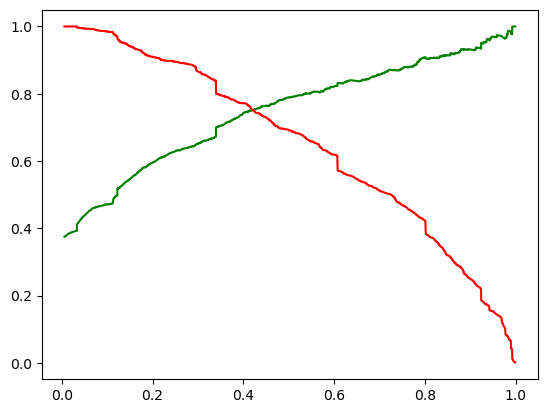

In [145]:
p, r, thresholds = precision_recall_curve(y_pred_final.Converted, y_pred_final.Conversion_prob)

plt.plot(thresholds, p[:-1], "g-")
plt.plot(thresholds, r[:-1], "r-")
plt.show()

##### Feature importance

In [146]:
# Displaying features with corresponding coefficients in final model
pd.options.display.float_format = '{:.2f}'.format
params = lg_model.params[1:]
params

Total Time Spent on Website                             1.12
Lead Origin_Lead Add Form                               3.44
Lead Source_Olark Chat                                  1.38
Lead Source_Welingak Website                            2.04
Last Activity_Converted to Lead                        -1.33
Last Activity_Email Bounced                            -1.84
Last Activity_Not specified                            -1.62
Last Activity_Olark Chat Conversation                  -1.40
Last Activity_SMS Sent                                  1.10
What is your current occupation_Not specified          -1.30
What is your current occupation_Working Professional    2.35
Last Notable Activity_Unreachable                       1.79
dtype: float64

In [147]:
# Relative feature importance
feature_importance = params
feature_importance = 100.0 * (feature_importance / feature_importance.max())
feature_importance

Total Time Spent on Website                             32.63
Lead Origin_Lead Add Form                              100.00
Lead Source_Olark Chat                                  40.21
Lead Source_Welingak Website                            59.15
Last Activity_Converted to Lead                        -38.51
Last Activity_Email Bounced                            -53.36
Last Activity_Not specified                            -47.17
Last Activity_Olark Chat Conversation                  -40.75
Last Activity_SMS Sent                                  31.95
What is your current occupation_Not specified          -37.90
What is your current occupation_Working Professional    68.14
Last Notable Activity_Unreachable                       51.96
dtype: float64

In [148]:
# Sorting features based on importance
sort_on_imp= np.argsort(feature_importance,kind='quicksort',order='list of str')
sort_on_imp

Total Time Spent on Website                              5
Lead Origin_Lead Add Form                                6
Lead Source_Olark Chat                                   7
Lead Source_Welingak Website                             4
Last Activity_Converted to Lead                          9
Last Activity_Email Bounced                              8
Last Activity_Not specified                              0
Last Activity_Olark Chat Conversation                    2
Last Activity_SMS Sent                                  11
What is your current occupation_Not specified            3
What is your current occupation_Working Professional    10
Last Notable Activity_Unreachable                        1
dtype: int64

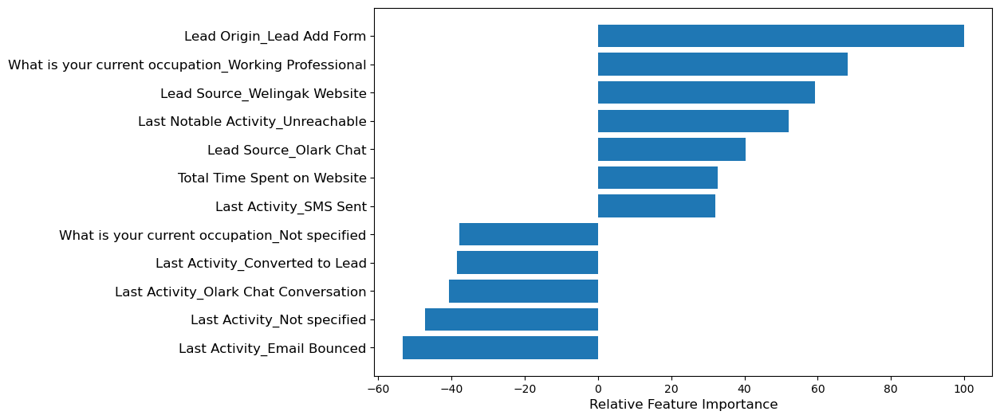

In [149]:
# Plotting features with their relative importance
fig = plt.figure(figsize=(10,6))
ax = fig.add_subplot(1, 1, 1)
pos = np.arange(sort_on_imp.shape[0])
ax.barh(pos, feature_importance[sort_on_imp])
ax.set_yticks(pos)
ax.set_yticklabels(np.array(X_train[sel_col].columns)[sort_on_imp], fontsize=12)
ax.set_xlabel('Relative Feature Importance', fontsize=12) 
plt.show()

### Conclusion:
- The final model built has all P values as almost zero and VIFs are also very low. Hence there is hardly any multicollinearity
- The metrics show a pretty good achievement of Accuracy : 81%, Sensitivity: 79%, Specificity: 82% & Precision: 74%. The metrics for training dataset is also almost same
- The lead score calculated on both training & test dataset shows a conversion rate on final predicted model around 80%
- Hence the overall model built seems good
- 12 features selected as most important ones in predicting the conversion is listed in the graph above. Features having positive and negative impact on the conversion probability are also included in the graph


##### Recommendations (Additional):

- Since 'API' and 'Landing Page Submission' generate the most leads but have less conversion rates, target to increase the conversion rate from these origins. Also focus on increasing leads generated using 'Lead Add Form' as the conversation rate is pretty high at 93%

- To improve overall lead conversion rate, focus on improving lead conversion of olark chat and generate more leads from welingak website as the conversion rate is too high at 99%

- Company should focus on working professionals as they are easier to convert with good conversion rate of 92%

- Focus on total time spent on website as it has a positive correlation with conversion. Also, attention should be given to the prospects whose last activity is 'SMS sent' as 63% of convertions are happening based on it


The X Education can concentrate on the above to increase their lead convertion chances further and have high number of potential buyers for their courses.
